# Convolutional Neural Network

### Importing the libraries

In [1]:
import tensorflow as tf
from keras.preprocessing.image import ImageDataGenerator

In [2]:
from keras.callbacks import ModelCheckpoint

In [3]:
tf.__version__

'2.14.0'

## Part 1 - Data Preprocessing

### Preprocessing the Training set

In [4]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)
training_set = train_datagen.flow_from_directory('dataset/training_set',
                                                 target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'binary')

Found 8000 images belonging to 2 classes.


### Preprocessing the Test set

In [5]:
test_datagen = ImageDataGenerator(rescale = 1./255)
test_set = test_datagen.flow_from_directory('dataset/test_set',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'binary')

Found 2000 images belonging to 2 classes.


## Part 2 - Building the CNN

### Initialising the CNN

In [6]:
cnn = tf.keras.models.Sequential()

### Step 1 - Convolution

In [7]:
cnn.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=[64, 64, 3]))

### Step 2 - Pooling

In [8]:
cnn.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2))

### Adding a second convolutional layer

In [9]:
cnn.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu'))
cnn.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2))

### Step 3 - Flattening

In [10]:
cnn.add(tf.keras.layers.Flatten())

### Step 4 - Full Connection

In [11]:
cnn.add(tf.keras.layers.Dense(units=128, activation='relu'))

### Step 5 - Output Layer

In [12]:
cnn.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

## Part 3 - Training the CNN

### Compiling the CNN

In [13]:
cnn.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

### Training the CNN on the Training set and evaluating it on the Test set

In [14]:
filename = 'cnn.h5'
checkpoint = ModelCheckpoint(filename,save_best_only=True)
cnn.fit(x = training_set, validation_data = test_set, epochs = 25,callbacks=[checkpoint])

Epoch 1/25


250/250 [==============================] - 127s 495ms/step - loss: 0.6646 - accuracy: 0.6021 - val_loss: 0.6304 - val_accuracy: 0.6465


c:\Users\welcome\anaconda3\Lib\site-packages\keras\src\engine\training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 2/25
250/250 [==============================] - 111s 445ms/step - loss: 0.5948 - accuracy: 0.6816 - val_loss: 0.5697 - val_accuracy: 0.6990
Epoch 3/25
250/250 [==============================] - 108s 434ms/step - loss: 0.5562 - accuracy: 0.7091 - val_loss: 0.5281 - val_accuracy: 0.7370
Epoch 4/25
250/250 [==============================] - 110s 438ms/step - loss: 0.5212 - accuracy: 0.7377 - val_loss: 0.5297 - val_accuracy: 0.7400
Epoch 5/25
250/250 [==============================] - 125s 501ms/step - loss: 0.5042 - accuracy: 0.7505 - val_loss: 0.4887 - val_accuracy: 0.7630
Epoch 6/25
250/250 [==============================] - 108s 432ms/step - loss: 0.4878 - accuracy: 0.7619 - val_loss: 0.4850 - val_accuracy: 0.7695
Epoch 7/25
250/250 [==============================] - 119s 475ms/step - loss: 0.4667 - accuracy: 0.7759 - val_loss: 0.4824 - val_accuracy: 0.7685
Epoch 8/25
250/250 [==============================] - 102s 408ms/step - loss: 0.4527 - accuracy: 0.7831 - val_loss: 0.4714 -

In [15]:
#cnn.fit(x = training_set, validation_data = test_set, epochs = 25)

## Part 4 - Making a single prediction

In [26]:
from tensorflow.keras.preprocessing import image
import numpy as np

test_image = image.load_img('dataset\\single_prediction\\cat.jpg', target_size=(64, 64))
timage = image.load_img('dataset\\single_prediction\\cat.jpg')
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis=0)
result = cnn.predict(test_image/255.0)
training_set.class_indices

if result[0][0] > 0.5:
    prediction = 'dog'
else:
    prediction = 'cat'


1/1 [==============================] - 0s 48ms/step


In [27]:
print(result)
print(prediction)

if (prediction=='cat'):
    print ('meow meow')
else:
    print ('who let the dog out')

[[0.03107883]]
cat
meow meow


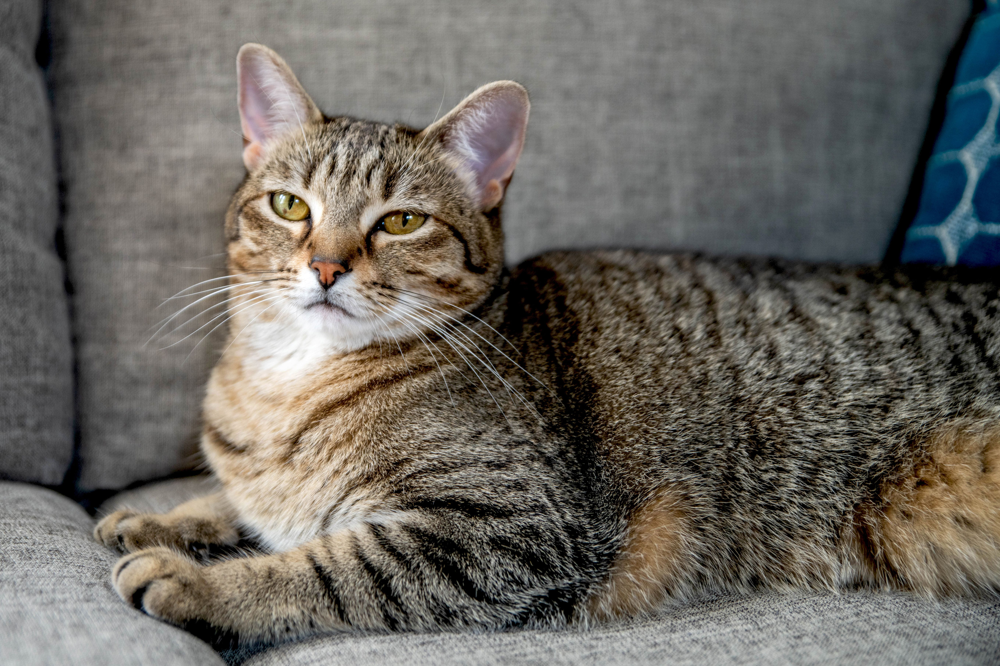

In [28]:
timage